In [ ]:
import numpy as np
import pandas as pd
from keras.models import Sequential
from keras.layers import LSTM
from keras.layers import Dense
import matplotlib.pyplot as plt


In [ ]:
df = pd.read_csv('/content/Solcast_Data.csv')

df

,Year,Month,Day,Hour,Minute,Tamb,Albedo,Azimuth,Cloudopacity,DewPoint,DHI,DNI,EBH,GHI,GtiFixedTilt,GtiTracking,Pw,Pressure,SnowDepth,WindDir,WindVel,Zenith
0,2018,1,1,0,0,17.5,0.15,-142,0.0,13.6,0,0,0,0,0,0,1.88,922.3,0,88,2.0,166
1,2018,1,1,1,0,16.8,0.15,-118,0.0,13.9,0,0,0,0,0,0,1.87,921.9,0,84,2.0,154
2,2018,1,1,2,0,16.7,0.15,-111,0.0,14.3,0,0,0,0,0,0,1.86,921.7,0,83,1.9,141
3,2018,1,1,3,0,17.3,0.15,-109,0.0,15.0,0,0,0,0,0,0,1.84,921.6,0,85,1.7,127
4,2018,1,1,4,0,17.8,0.15,-110,0.0,15.7,0,0,0,0,0,0,1.83,921.6,0,88,1.5,114
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17539,2020,1,1,19,0,21.8,0.15,110,0.0,17.5,0,0,0,0,0,0,3.30,918.4,0,95,4.0,117
17540,2020,1,1,20,0,21.0,0.15,110,0.0,17.7,0,0,0,0,0,0,3.36,919.1,0,92,4.7,131
17541,2020,1,1,21,0,20.4,0.15,112,0.0,17.7,0,0,0,0,0,0,3.45,919.5,0,92,5.0,145
17542,2020,1,1,22,0,20.0,0.15,121,0.0,17.6,0,0,0,0,0,0,3.35,919.4,0,95,4.5,158


In [ ]:
def split_sequence(sequence, n_steps_in, n_steps_out):
  X, y = list(), list()
  for i in range(len(sequence)):
    end_ix = i + n_steps_in
    out_end_ix = end_ix + n_steps_out
    if out_end_ix > len(sequence):
      break
    seq_x, seq_y = sequence[i:end_ix], sequence[end_ix:out_end_ix]
    X.append(seq_x)
    y.append(seq_y)
  return np.array(X), np.array(y)

In [ ]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [ ]:
df

,Year,Month,Day,Hour,Minute,Tamb,Albedo,Azimuth,Cloudopacity,DewPoint,DHI,DNI,EBH,GHI,GtiFixedTilt,GtiTracking,Pw,Pressure,SnowDepth,WindDir,WindVel,Zenith
0,2018,1,1,0,0,17.5,0.15,-142,0.0,13.6,0,0,0,0,0,0,1.88,922.3,0,88,2.0,166
1,2018,1,1,1,0,16.8,0.15,-118,0.0,13.9,0,0,0,0,0,0,1.87,921.9,0,84,2.0,154
2,2018,1,1,2,0,16.7,0.15,-111,0.0,14.3,0,0,0,0,0,0,1.86,921.7,0,83,1.9,141
3,2018,1,1,3,0,17.3,0.15,-109,0.0,15.0,0,0,0,0,0,0,1.84,921.6,0,85,1.7,127
4,2018,1,1,4,0,17.8,0.15,-110,0.0,15.7,0,0,0,0,0,0,1.83,921.6,0,88,1.5,114
5,2018,1,1,5,0,18.4,0.15,-112,0.0,15.8,0,0,0,0,0,0,1.81,922.0,0,90,1.3,100
6,2018,1,1,6,0,19.0,0.15,-115,17.1,15.5,27,3,0,27,27,27,1.79,922.7,0,90,1.0,87
7,2018,1,1,7,0,19.6,0.15,-119,28.1,15.2,146,82,28,175,185,231,1.77,923.4,0,90,0.7,74
8,2018,1,1,8,0,20.9,0.15,-126,3.8,14.6,123,649,321,444,521,718,1.75,923.7,0,85,0.6,61
9,2018,1,1,9,0,23.0,0.15,-136,7.1,13.7,194,639,400,594,672,749,1.74,923.6,0,75,0.6,50


In [ ]:
df_spring = df.iloc[1416:3624,11]

In [ ]:
type(df_spring)

pandas.core.series.Series

In [ ]:
raw_seq = df_spring.to_numpy()
raw_seq

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
n_steps_in, n_steps_out = 24, 24
X, y = split_sequence(raw_seq, n_steps_in, n_steps_out)

for i in range(len(X)):
  print(X[i],y[i])

Streaming output truncated to the last 5000 lines.
   6 463 643 714 814 839]
[708 317 339 139   0   0   0   0   0   0   0   0   0   0   0   1   2   0
  36 569 676 559 519 500] [381 272  89  89   0   0   0   0   0   0   0   0   0   0   0   0   1   6
 463 643 714 814 839 819]
[317 339 139   0   0   0   0   0   0   0   0   0   0   0   1   2   0  36
 569 676 559 519 500 381] [272  89  89   0   0   0   0   0   0   0   0   0   0   0   0   1   6 463
 643 714 814 839 819 730]
[339 139   0   0   0   0   0   0   0   0   0   0   0   1   2   0  36 569
 676 559 519 500 381 272] [ 89  89   0   0   0   0   0   0   0   0   0   0   0   0   1   6 463 643
 714 814 839 819 730 639]
[139   0   0   0   0   0   0   0   0   0   0   0   1   2   0  36 569 676
 559 519 500 381 272  89] [ 89   0   0   0   0   0   0   0   0   0   0   0   0   1   6 463 643 714
 814 839 819 730 639 472]
[  0   0   0   0   0   0   0   0   0   0   0   1   2   0  36 569 676 559
 519 500 381 272  89  89] [  0   0   0   0   0   0   0   0

In [ ]:
n_features = 1
X = X.reshape((X.shape[0], X.shape[1], n_features))

In [ ]:
#define model
model = Sequential()
model.add(LSTM(100, activation = 'relu',return_sequences=True, input_shape=(n_steps_in, n_features)))
model.add(LSTM(100, activation='relu'))
model.add(Dense(n_steps_out))
model.compile(optimizer='adam', loss='mse')

In [ ]:
model.fit(X,y,epochs=50, verbose=0)

In [ ]:
x_input = np.array(df.iloc[10488:10512,11])
x_input = x_input.reshape(1,n_steps_in,n_features)
yhat = model.predict(x_input, verbose=0)


In [ ]:
print(yhat)

[[-14.827896 -52.201107 -47.67411  -64.89382  -11.321684 -28.228867
   73.73963  196.22818  398.51825  656.2835   828.93384  942.74786
  941.44934  826.1792   646.4389   448.29358  260.7347   142.10172
   26.316101 -19.217932 -40.047436 -50.253193 -38.05024    8.391963]]


In [ ]:
pred = np.squeeze(np.asarray(yhat))

In [ ]:
prediction = pred[8:len(pred)-6]

In [ ]:
prediction

array([398.51825, 656.2835 , 828.93384, 942.74786, 941.44934, 826.1792 ,
       646.4389 , 448.29358, 260.7347 , 142.10172], dtype=float32)

In [ ]:
print(np.array(df.iloc[10488:10512,11]))

[  0   0   0   0   0   0  11 541 761 835 872 888 880 852 802 711 539  80
   0   0   0   0   0   0]


In [ ]:
actual = np.array(df.iloc[10488+6+2:10512-6,11])
actual

array([761, 835, 872, 888, 880, 852, 802, 711, 539,  80])

In [ ]:
mape = np.mean(abs((actual-prediction)/(actual)))*100

In [ ]:
mape

27.575190204819023

In [ ]:
df.index[10488+6+2:10512-6]

RangeIndex(start=10496, stop=10506, step=1)

<function matplotlib.pyplot.show>

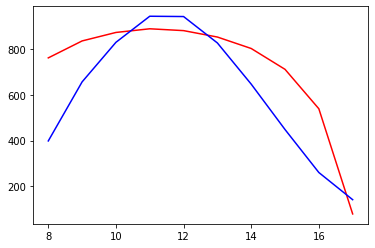

In [ ]:
plt.plot(df.iloc[10488+6+2:10512-6,3],actual,'r')
plt.plot(df.iloc[10488+6+2:10512-6,3],prediction,'b')
plt.show

In [ ]:
actual_mean = np.mean(actual)
deviation = abs(prediction - actual_mean)
MAD = np.mean(deviation)